<div style="text-align: center;">
  <img src="https://github.com/Hack-io-Data/Imagenes/blob/main/01-LogosHackio/logo_naranja@4x.png?raw=true" alt="esquema" />
</div>


# Laboratorio de Gestión de Outliers

AutoRenew, la empresa líder en la venta de coches de segunda mano, sigue adelante con el desarrollo del modelo predictivo que ayudará a estimar el precio de los vehículos usados. Este modelo es clave para mejorar las estrategias de ventas, marketing y optimización del inventario de la empresa. Ya has realizado un análisis exploratorio inicial y gestionado los valores nulos en el conjunto de datos. Ahora, es el momento de abordar otro aspecto crucial del preprocesamiento: la **gestión de outliers**.

En este laboratorio, te enfocarás en identificar y gestionar los outliers (valores atípicos) presentes en el conjunto de datos. Los outliers pueden distorsionar los resultados de un análisis y afectar negativamente el rendimiento de los modelos predictivos, por lo que es fundamental tratarlos adecuadamente antes de proceder con las siguientes fases del proyecto.


**Instrucciones:**

1. **Identificación de Outliers:** Explora las columnas clave del conjunto de datos (como `price`, `powerCV`, `kilometer`, etc.) para identificar posibles outliers. Utiliza gráficos como diagramas de caja (boxplots) y análisis estadísticos para detectar valores que se desvíen significativamente del resto de los datos.

2. **Análisis de Outliers:** Una vez identificados, analiza los outliers para determinar si son errores de datos, valores extremos válidos o resultados de condiciones específicas que deben ser tenidos en cuenta. Considera el contexto de cada columna al evaluar la relevancia de estos valores atípicos.

3. **Gestión de Outliers:** Decide la estrategia más adecuada para manejar los outliers. Esto podría incluir la eliminación de los outliers, la transformación de los datos, o la aplicación de técnicas de imputación. Justifica tu elección basándote en cómo los outliers podrían afectar el modelo predictivo.

**Nota:** Recuerda que este laboratorio es parte de una serie de actividades en las que utilizarás el mismo conjunto de datos a lo largo de la semana. Documenta cuidadosamente los pasos que sigas para que puedas referirte a ellos en las próximas etapas del proyecto.


In [1]:
# Tratamiento de datos
# -----------------------------------------------------------------------
import numpy as np
import pandas as pd

# Otros objetivos
# -----------------------------------------------------------------------
import math

# Gráficos
# -----------------------------------------------------------------------
import seaborn as sns
import matplotlib.pyplot as plt

import os
import sys 
sys.path.append(os.path.abspath("../src"))   
import soporte_preprocesamiento as f
import warnings
warnings.filterwarnings("ignore")




# Imputación de nulos usando métodos avanzados estadísticos
# -----------------------------------------------------------------------
from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.impute import KNNImputer
from sklearn.ensemble import RandomForestRegressor



from sklearn.preprocessing import MinMaxScaler, Normalizer, StandardScaler, RobustScaler


from tqdm import tqdm


# import plotly_express as px


# Métodos estadísticos
# -----------------------------------------------------------------------
from scipy.stats import zscore # para calcular el z-score
from sklearn.neighbors import LocalOutlierFactor # para detectar outliers usando el método LOF
from sklearn.ensemble import IsolationForest # para detectar outliers usando el metodo IF
from sklearn.neighbors import NearestNeighbors # para calcular la epsilon

# Para generar combinaciones de listas
# -----------------------------------------------------------------------
from itertools import product, combinations



In [2]:
df_robust=pd.read_csv("..\datos3\datos_con_robust.csv", index_col=0).reset_index(drop=True)


In [3]:
df_robust["yearCreated"]=df_robust["yearCreated"].astype("category")
df_robust["monthCreated"]=df_robust["monthCreated"].astype("category")

In [4]:
df_robust.head(2)

,dateCrawled,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,model,monthOfRegistration,fuelType,brand,notRepairedDamage,lastSeen,yearCreated,monthCreated,powerCV_robust,kilometer_robust
0,2016-03-24 11:52:17,private,offer,480,test,other,moderno,manually,golf,desconocido,petrol,volkswagen,desconocido,2016-04-07 03:16:57,2016,3,0.017658,0.0
1,2016-03-24 10:58:45,private,offer,18300,test,coupe,actual,manually,desconocido,5,diesel,audi,yes,2016-04-07 01:46:50,2016,3,1.155172,-1.0


Primero identificamos los outliers en univariados

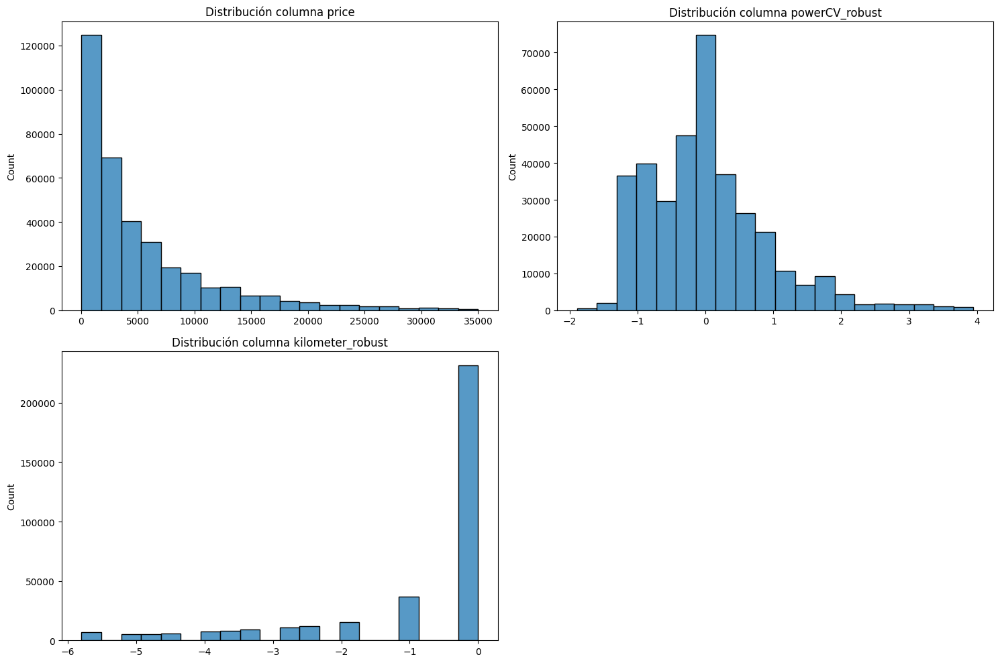

In [5]:
f.plot_outliers_univariados(df_robust, "h", (15,10))

Recuerdo la distribución de las numéricas ya seleccionadas mediante la metodología de escalador robusto

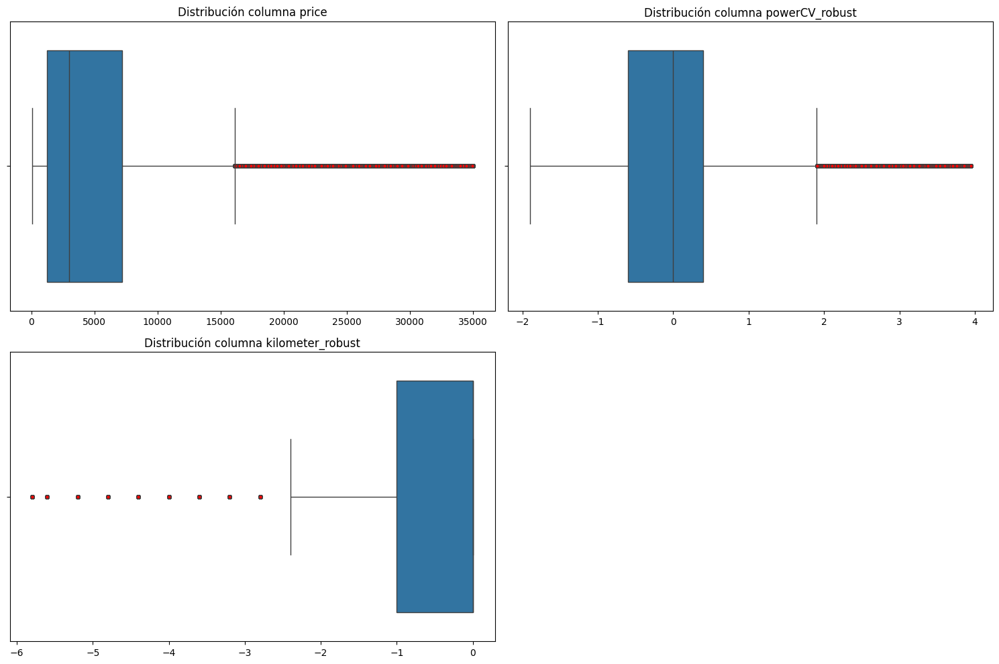

In [6]:
f.plot_outliers_univariados(df_robust, "b", (15,10))

Observo los outliers de las numéricas ya seleccionadas mediante la metodología de escalador robusto

In [7]:
num=df_robust.select_dtypes(include=np.number)
num.describe().T

,count,mean,std,min,25%,50%,75%,max
price,354691.0,5359.193264,5999.952254,55.000000,1250.000000,3000.0,7200.000000,34999.000000
powerCV_robust,354691.0,0.017658,0.873586,-1.896552,-0.603448,0.0,0.396552,3.948276
kilometer_robust,354691.0,-0.938254,1.557094,-5.800000,-1.000000,0.0,0.000000,0.000000


In [8]:
dicc_zsc=f.identificar_outliers_zscore(df_robust)

La cantidad de outliers para la PRICE es de 8607 outliers
La cantidad de outliers para la POWERCV_ROBUST es de 5569 outliers
La cantidad de outliers para la KILOMETER_ROBUST es de 5268 outliers


Dado que no tienen una distribución normal ninguna de ellas, no utilizaré el Z-Score ya que el porcentaje de fallo será demasiado alto. Por ello opto por el IQR

In [9]:
dicc_iqr=f.identificar_outliers_iqr(df_robust)

La columna PRICE tiene 24242 outliers
La columna POWERCV_ROBUST tiene 12655 outliers
La columna KILOMETER_ROBUST tiene 58773 outliers


In [10]:
dicc_iqr["price"].head(2)

,dateCrawled,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,model,monthOfRegistration,fuelType,brand,notRepairedDamage,lastSeen,yearCreated,monthCreated,powerCV_robust,kilometer_robust
1,2016-03-24 10:58:45,private,offer,18300,test,coupe,actual,manually,desconocido,5,diesel,audi,yes,2016-04-07 01:46:50,2016,3,1.155172,-1.0
13,2016-03-21 12:57:01,private,offer,17999,control,suv,actual,manually,navara,3,diesel,nissan,no,2016-04-06 07:45:42,2016,3,1.155172,-3.2


In [11]:
dicc_iqr["powerCV_robust"].head(2)

,dateCrawled,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,model,monthOfRegistration,fuelType,brand,notRepairedDamage,lastSeen,yearCreated,monthCreated,powerCV_robust,kilometer_robust
39,2016-03-30 20:38:20,private,offer,7500,control,other,moderno,automatic,e_klasse,4,other,mercedes_benz,desconocido,2016-04-03 11:44:49,2016,3,3.137931,0.0
99,2016-03-16 16:44:10,private,offer,22999,control,coupe,actual,automatic,andere,4,petrol,hyundai,no,2016-04-06 20:18:22,2016,3,3.086207,-4.0


In [12]:
dicc_iqr["kilometer_robust"].head(2)

,dateCrawled,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,model,monthOfRegistration,fuelType,brand,notRepairedDamage,lastSeen,yearCreated,monthCreated,powerCV_robust,kilometer_robust
7,2016-04-04 23:42:13,private,offer,14500,control,bus,actual,manually,c_max,8,petrol,ford,desconocido,2016-04-04 23:42:13,2016,4,0.051724,-4.8
13,2016-03-21 12:57:01,private,offer,17999,control,suv,actual,manually,navara,3,diesel,nissan,no,2016-04-06 07:45:42,2016,3,1.155172,-3.2


Observamos como el número de outliers es muy elevado por lo general y no parecen estar muy separados entre ellos. Esto me lleva a pensar que un LOF podría ser la mejor opción. Sin embargo, vamos a comprobarlo. 

In [13]:
contaminacion= [0.01, 0.05, 0.1]
estimadores = [100,400,1000, 2000] 
combinaciones= list(product(contaminacion, estimadores))
for cont, esti in combinaciones:
    
    ifo=IsolationForest(random_state=42, n_estimators=esti, contamination= cont, n_jobs=-1)         #n_estimator es el número de árboles y n_jobs con -1 coge todos los nucleos del ordenador

    df_robust[f"outliers_ifo_{cont}_{esti}"]=ifo.fit_predict(df_robust[["price","powerCV_robust","kilometer_robust"]]) 

In [14]:
df_robust["outliers_ifo_0.01_100"].value_counts(normalize=True)    #Esto nos muetsra como se acerca mucho al 1% de outliers por el nivel de contaminación ser 0.01

outliers_ifo_0.01_100
 1    0.990003
-1    0.009997
Name: proportion, dtype: float64

In [15]:
df_robust.head()

,dateCrawled,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,model,monthOfRegistration,...,outliers_ifo_0.01_1000,outliers_ifo_0.01_2000,outliers_ifo_0.05_100,outliers_ifo_0.05_400,outliers_ifo_0.05_1000,outliers_ifo_0.05_2000,outliers_ifo_0.1_100,outliers_ifo_0.1_400,outliers_ifo_0.1_1000,outliers_ifo_0.1_2000
0,2016-03-24 11:52:17,private,offer,480,test,other,moderno,manually,golf,desconocido,...,1,1,1,1,1,1,1,1,1,1
1,2016-03-24 10:58:45,private,offer,18300,test,coupe,actual,manually,desconocido,5,...,1,1,1,1,1,1,-1,1,1,1
2,2016-03-14 12:52:21,private,offer,9800,test,suv,moderno,automatic,grand,8,...,1,1,1,1,1,1,1,1,1,1
3,2016-03-17 16:54:04,private,offer,1500,test,small car,moderno,manually,golf,6,...,1,1,1,1,1,1,1,1,1,1
4,2016-03-31 17:25:20,private,offer,3600,test,small car,moderno,manually,fabia,7,...,1,1,1,1,1,1,1,1,1,1


In [16]:
columnas_hue=df_robust.filter(like="outliers")

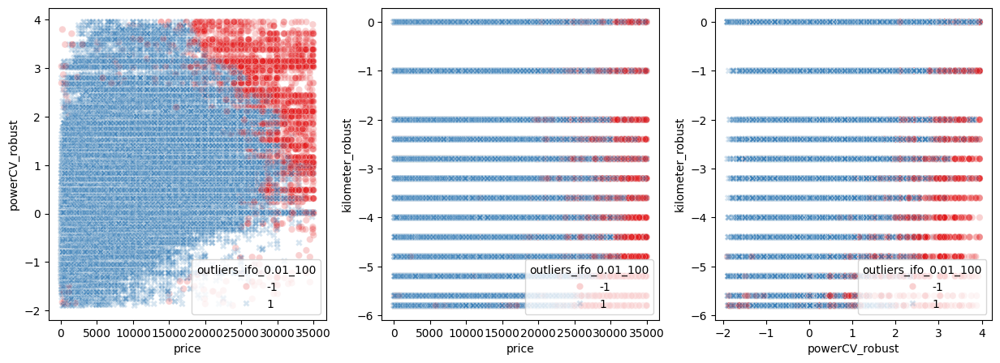

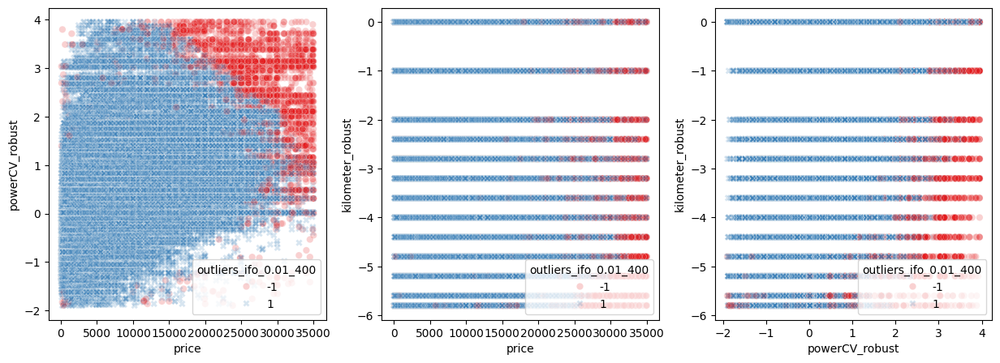

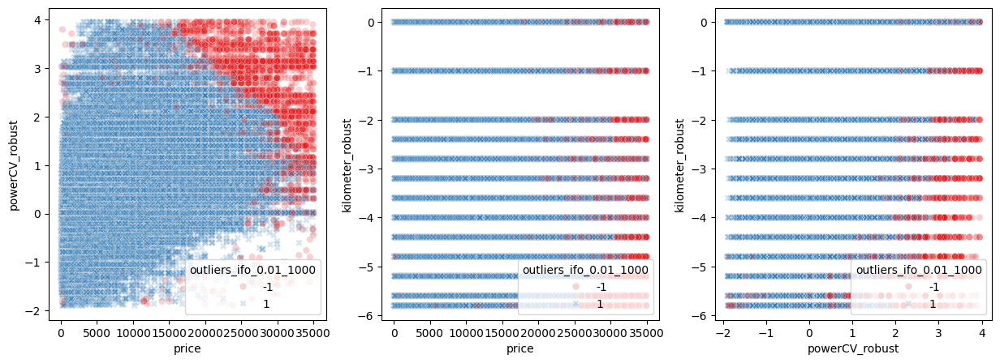

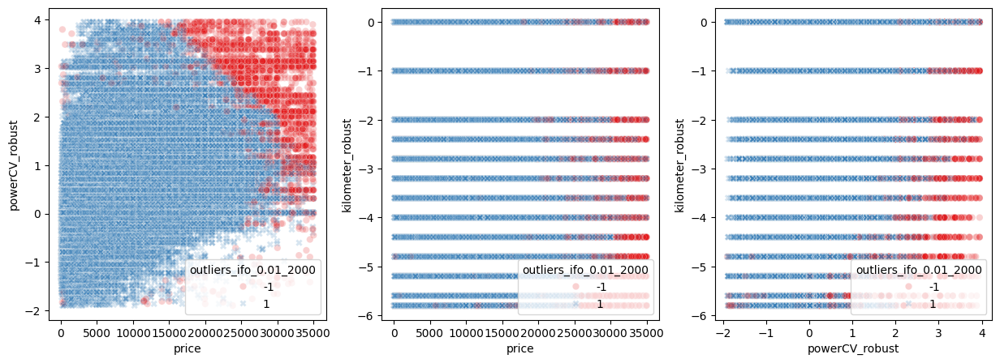

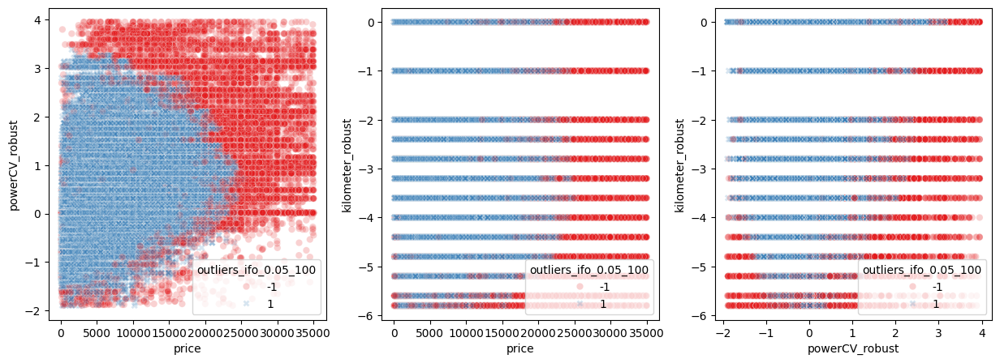

...

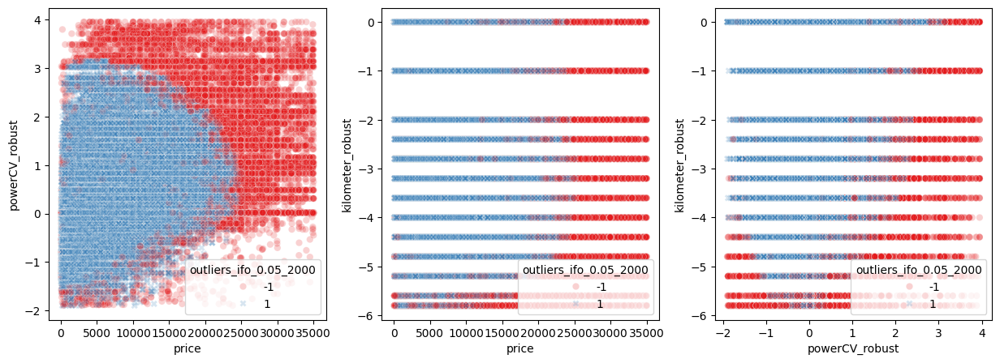

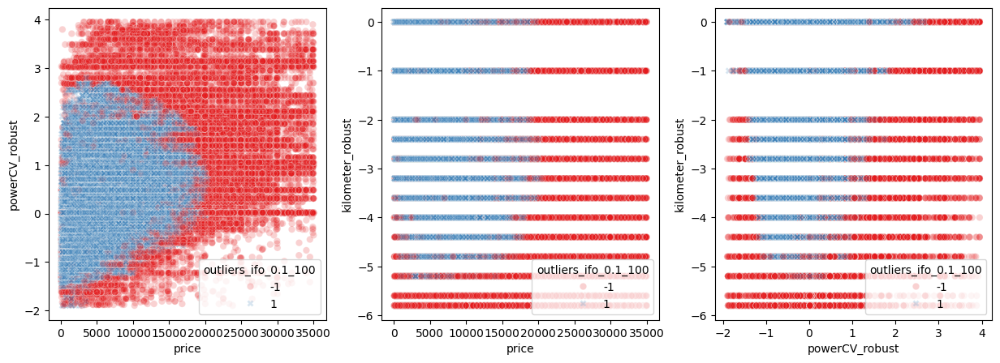

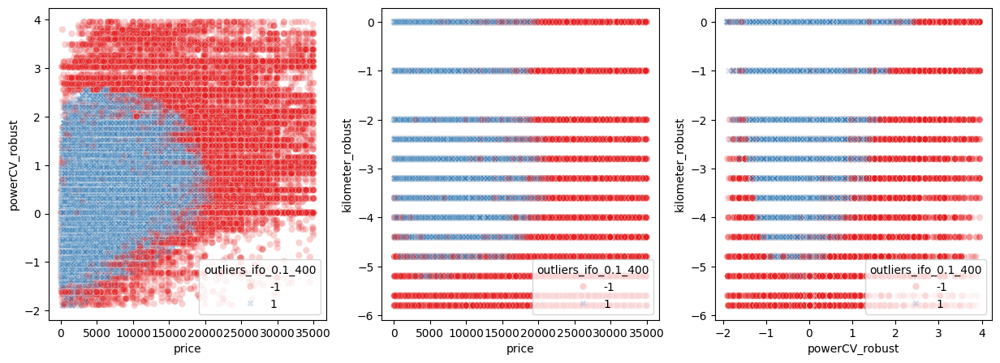

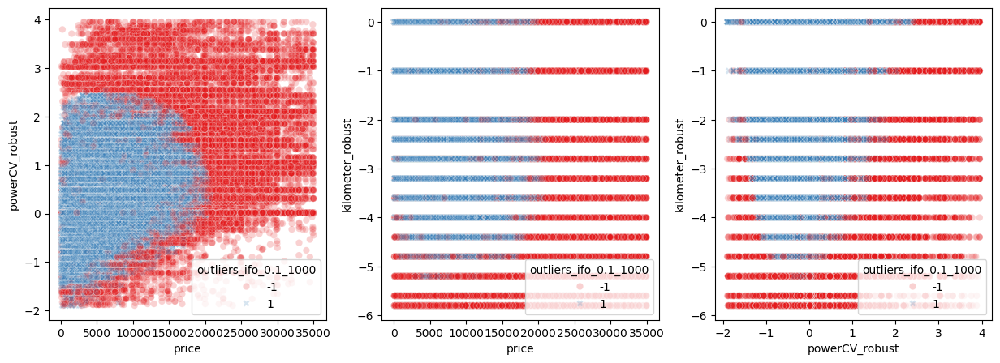

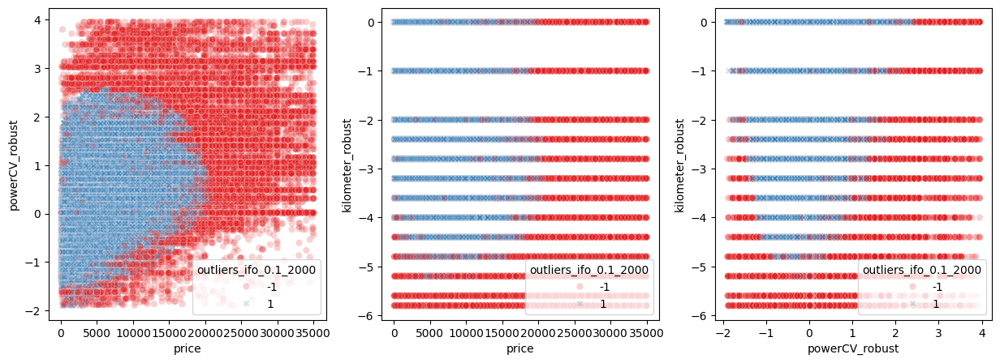

In [17]:
combinaciones_visual=list(combinations(["price","powerCV_robust","kilometer_robust"], 2))

for out in columnas_hue:


    fig, axes = plt.subplots(nrows=1,ncols=3, figsize=(15,5))
    axes=axes.flat
    for indice, tupla in enumerate(combinaciones_visual):
        sns.scatterplot(x=tupla[0], y=tupla[1], ax= axes[indice], data=df_robust, hue= out, palette= "Set1", alpha= 0.2, style= out)

Observamos como a mayor número de arboles los outliers se van agrupando más.  
Además según vamos siendo más estrictos con el nivel de contaminación, más sentido tiene la interpretación. 
Un ejemplo de esto es la conclusión del scaterplot entre los kilometros y la potencia. En este ejemplo se puede ver como los valores no outliers son a partir de lo que corresponde a unos 40.000km (además vamos viendo como van aumentando el número de vehículos según vamos yendo a kilometrajes más altos) y en el caso de la potencia se concentran entre las potencias bajas y los 180 caballos de potencia aproximadamente.  
  
Por otra parte, en los otros dos scatterplots, observamos como en el caso del precio los datos no outliers se encuentran entre 0 y los 23.000 € aproximadamente.

In [18]:
df_robust.head()

,dateCrawled,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,model,monthOfRegistration,...,outliers_ifo_0.01_1000,outliers_ifo_0.01_2000,outliers_ifo_0.05_100,outliers_ifo_0.05_400,outliers_ifo_0.05_1000,outliers_ifo_0.05_2000,outliers_ifo_0.1_100,outliers_ifo_0.1_400,outliers_ifo_0.1_1000,outliers_ifo_0.1_2000
0,2016-03-24 11:52:17,private,offer,480,test,other,moderno,manually,golf,desconocido,...,1,1,1,1,1,1,1,1,1,1
1,2016-03-24 10:58:45,private,offer,18300,test,coupe,actual,manually,desconocido,5,...,1,1,1,1,1,1,-1,1,1,1
2,2016-03-14 12:52:21,private,offer,9800,test,suv,moderno,automatic,grand,8,...,1,1,1,1,1,1,1,1,1,1
3,2016-03-17 16:54:04,private,offer,1500,test,small car,moderno,manually,golf,6,...,1,1,1,1,1,1,1,1,1,1
4,2016-03-31 17:25:20,private,offer,3600,test,small car,moderno,manually,fabia,7,...,1,1,1,1,1,1,1,1,1,1


A pesar de que las gráficas tienen sentido debido a la dispersión y cantidad de los datos es más correcto un LOF voy a sacarlos juntos para que se observe la diferencia en los scatter plots entre IFO y LOF

100%|██████████| 21/21 [02:22<00:00,  6.79s/it]


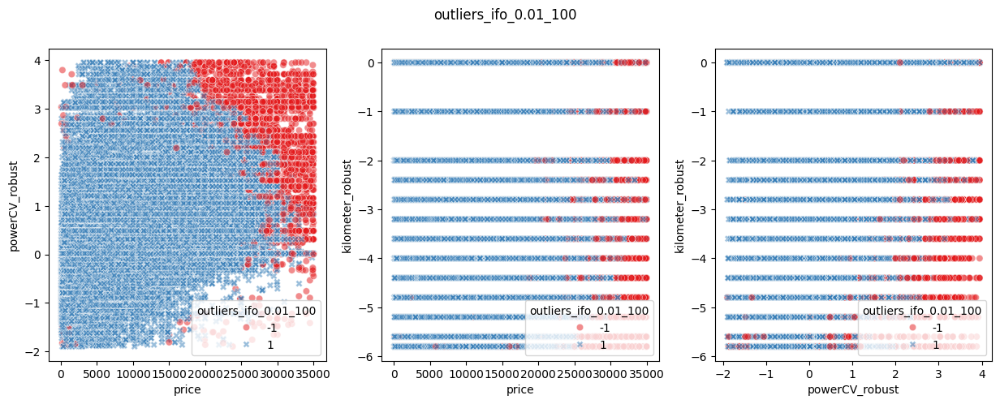

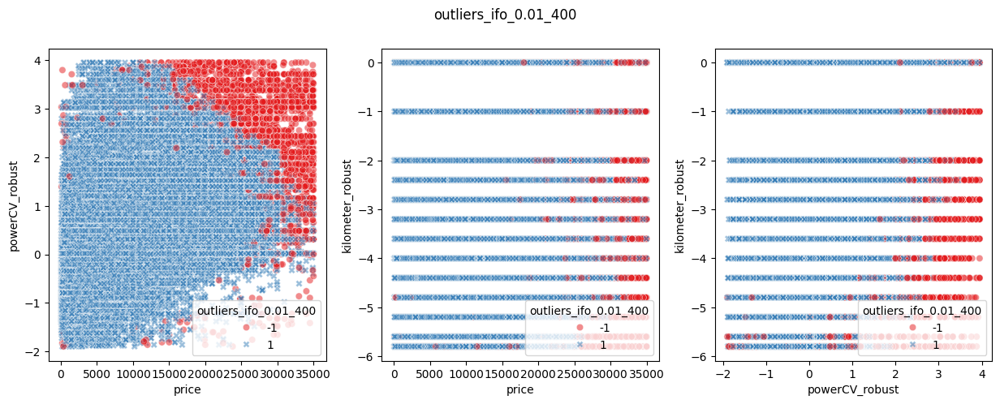

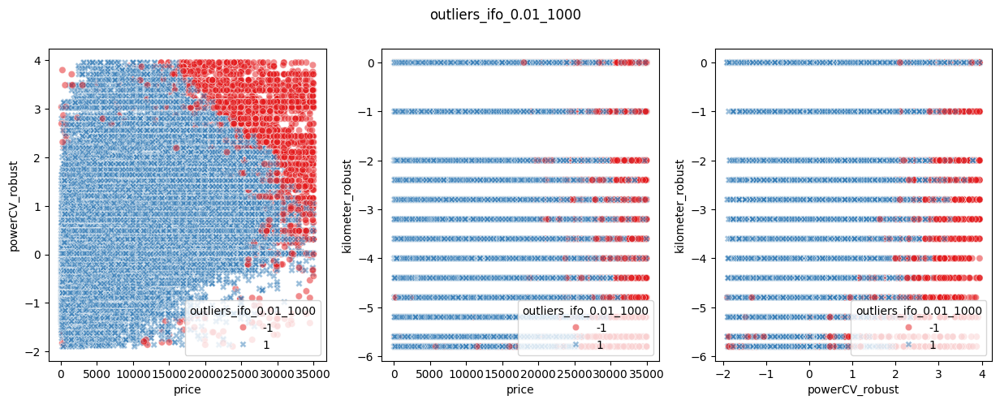

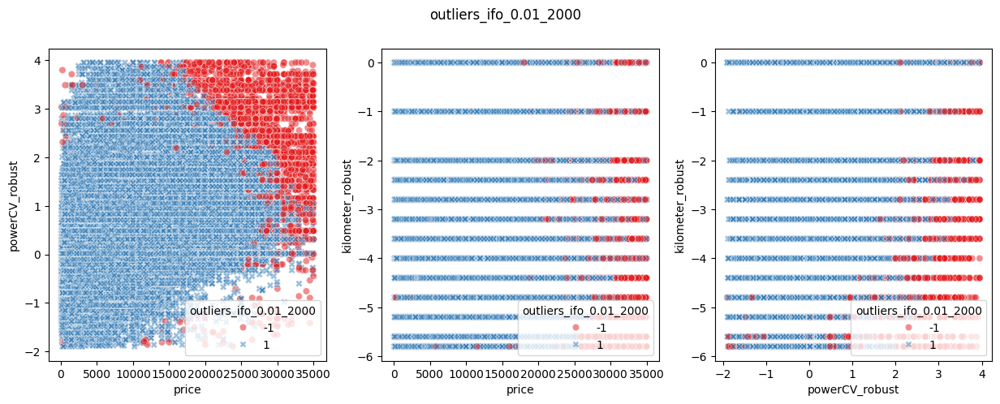

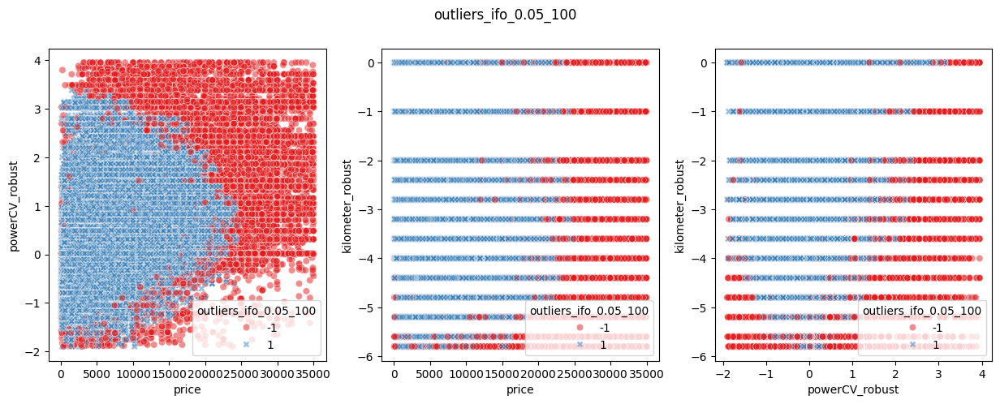

...

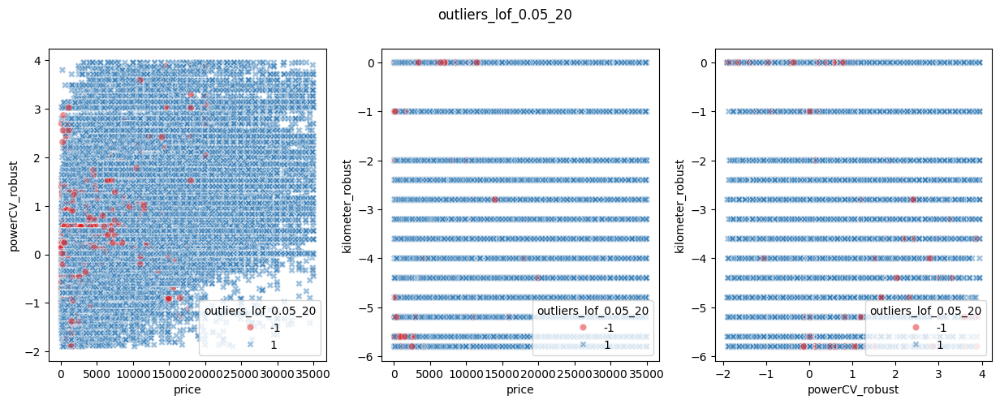

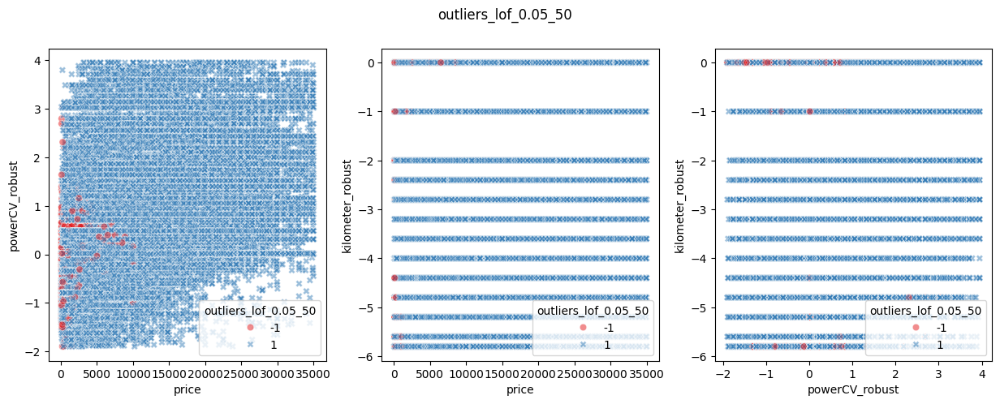

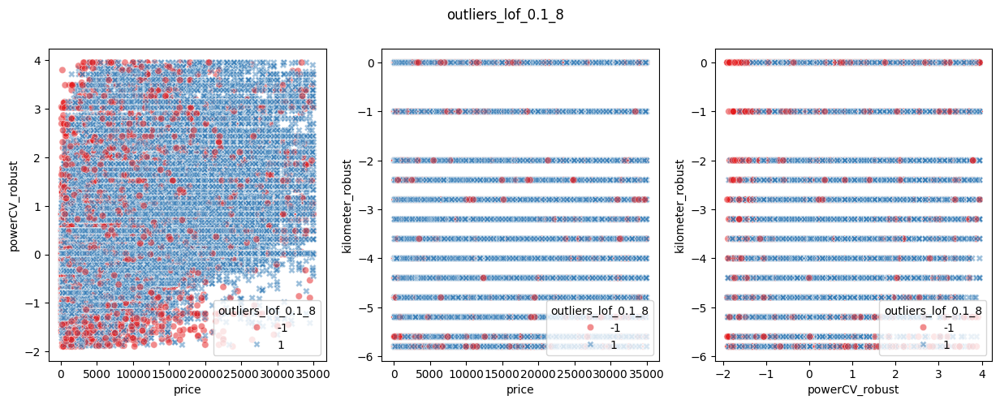

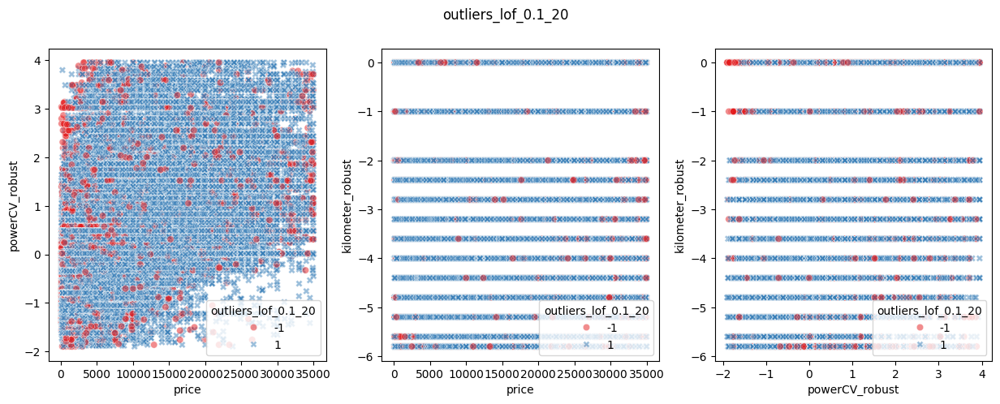

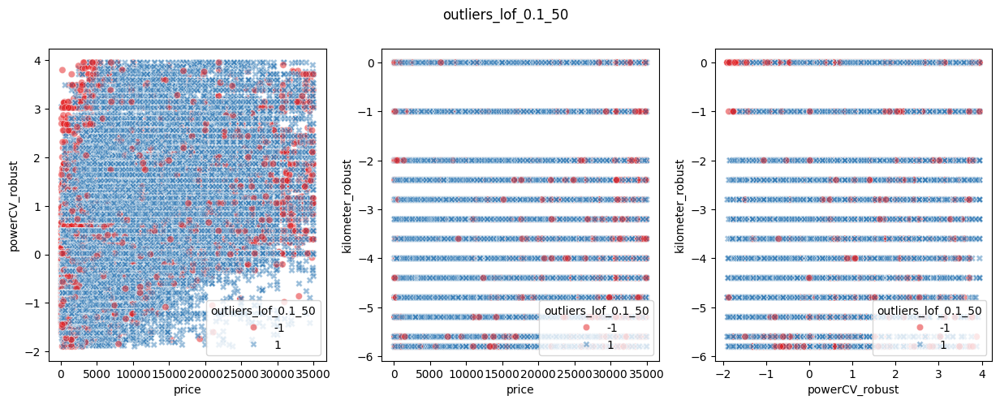

In [19]:
lista_contaminaciones = [0.01, 0.05, 0.1]
lista_neighbors = [8,20, 50]

combinaciones = list(product(lista_contaminaciones, lista_neighbors))
combinaciones


for cont, neighbors in tqdm(combinaciones):
    lof = LocalOutlierFactor(n_neighbors=neighbors,
                            contamination=cont,
                            n_jobs=-1)

    df_robust[f"outliers_lof_{cont}_{neighbors}"] = lof.fit_predict(df_robust[["price", "powerCV_robust", "kilometer_robust"]])
    y_pred = lof.fit_predict(df_robust[["price", "powerCV_robust", "kilometer_robust"]])
df_robust

#visualizacion
columnas_hue = df_robust.filter(like="outlier").columns

combinaciones_viz = list(combinations(["price", "powerCV_robust", "kilometer_robust"], 2))
combinaciones_viz

for outlier in tqdm(columnas_hue):
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize = (15, 5))
    axes = axes.flat

    for indice, tupla in enumerate(combinaciones_viz):
        sns.scatterplot(x = tupla[0],
                        y = tupla[1],
                        ax = axes[indice],
                        data = df_robust,
                        hue=outlier,
                        palette="Set1",
                        style=outlier,
                        alpha=0.5)
        
    plt.suptitle(outlier)

Lo que saco en claro es que el nivel de contaminación más estricto (10%) es la mejor opción porque es el que más se acerca a la realidad de los datos.  
En cuanto al número de vecinos, me gustaría coger menos vecinos a 20 (que es el que más parece reflejar la realidad) por ejemplo 8.  


In [20]:
df_robust.head()

,dateCrawled,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,model,monthOfRegistration,...,outliers_ifo_0.1_2000,outliers_lof_0.01_8,outliers_lof_0.01_20,outliers_lof_0.01_50,outliers_lof_0.05_8,outliers_lof_0.05_20,outliers_lof_0.05_50,outliers_lof_0.1_8,outliers_lof_0.1_20,outliers_lof_0.1_50
0,2016-03-24 11:52:17,private,offer,480,test,other,moderno,manually,golf,desconocido,...,1,1,1,1,1,1,1,1,1,1
1,2016-03-24 10:58:45,private,offer,18300,test,coupe,actual,manually,desconocido,5,...,1,1,1,1,1,1,1,1,1,1
2,2016-03-14 12:52:21,private,offer,9800,test,suv,moderno,automatic,grand,8,...,1,1,1,1,1,1,1,1,1,1
3,2016-03-17 16:54:04,private,offer,1500,test,small car,moderno,manually,golf,6,...,1,1,1,1,1,1,1,1,1,1
4,2016-03-31 17:25:20,private,offer,3600,test,small car,moderno,manually,fabia,7,...,1,1,1,1,1,1,1,1,1,1


In [21]:
df_robust.columns

Index(['dateCrawled', 'seller', 'offerType', 'price', 'abtest', 'vehicleType',
       'yearOfRegistration', 'gearbox', 'model', 'monthOfRegistration',
       'fuelType', 'brand', 'notRepairedDamage', 'lastSeen', 'yearCreated',
       'monthCreated', 'powerCV_robust', 'kilometer_robust',
       'outliers_ifo_0.01_100', 'outliers_ifo_0.01_400',
       'outliers_ifo_0.01_1000', 'outliers_ifo_0.01_2000',
       'outliers_ifo_0.05_100', 'outliers_ifo_0.05_400',
       'outliers_ifo_0.05_1000', 'outliers_ifo_0.05_2000',
       'outliers_ifo_0.1_100', 'outliers_ifo_0.1_400', 'outliers_ifo_0.1_1000',
       'outliers_ifo_0.1_2000', 'outliers_lof_0.01_8', 'outliers_lof_0.01_20',
       'outliers_lof_0.01_50', 'outliers_lof_0.05_8', 'outliers_lof_0.05_20',
       'outliers_lof_0.05_50', 'outliers_lof_0.1_8', 'outliers_lof_0.1_20',
       'outliers_lof_0.1_50'],
      dtype='object')

In [22]:
df_lof=df_robust[['dateCrawled', 'seller', 'offerType', 'price', 'abtest', 'vehicleType',
       'yearOfRegistration', 'gearbox', 'model', 'monthOfRegistration',
       'fuelType', 'brand', 'notRepairedDamage', 'lastSeen', 'yearCreated',
       'monthCreated', 'powerCV_robust', 'kilometer_robust', 'outliers_lof_0.01_20',
       'outliers_lof_0.01_50', 'outliers_lof_0.05_20',
       'outliers_lof_0.05_50', 'outliers_lof_0.1_20',
       'outliers_lof_0.1_50', 'outliers_lof_0.01_8', 'outliers_lof_0.05_8',
       'outliers_lof_0.1_8']]

In [23]:
df_lof.head()

,dateCrawled,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,model,monthOfRegistration,...,kilometer_robust,outliers_lof_0.01_20,outliers_lof_0.01_50,outliers_lof_0.05_20,outliers_lof_0.05_50,outliers_lof_0.1_20,outliers_lof_0.1_50,outliers_lof_0.01_8,outliers_lof_0.05_8,outliers_lof_0.1_8
0,2016-03-24 11:52:17,private,offer,480,test,other,moderno,manually,golf,desconocido,...,0.0,1,1,1,1,1,1,1,1,1
1,2016-03-24 10:58:45,private,offer,18300,test,coupe,actual,manually,desconocido,5,...,-1.0,1,1,1,1,1,1,1,1,1
2,2016-03-14 12:52:21,private,offer,9800,test,suv,moderno,automatic,grand,8,...,-1.0,1,1,1,1,1,1,1,1,1
3,2016-03-17 16:54:04,private,offer,1500,test,small car,moderno,manually,golf,6,...,0.0,1,1,1,1,1,1,1,1,1
4,2016-03-31 17:25:20,private,offer,3600,test,small car,moderno,manually,fabia,7,...,-2.4,1,1,1,1,1,1,1,1,1


Ahora me quito las que tengan todas las filas con 1 y así me quedo con todas las que al menos tienen un Outlier

In [24]:
columnasdf=df_robust.filter(like="outliers_lof")
columnas_lof=columnasdf.columns

In [25]:

filtered_df = df_lof[(df_lof[columnas_lof] == -1).all(axis=1)]

In [26]:
filtered_df.head()

,dateCrawled,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,model,monthOfRegistration,...,kilometer_robust,outliers_lof_0.01_20,outliers_lof_0.01_50,outliers_lof_0.05_20,outliers_lof_0.05_50,outliers_lof_0.1_20,outliers_lof_0.1_50,outliers_lof_0.01_8,outliers_lof_0.05_8,outliers_lof_0.1_8
304,2016-03-21 14:38:37,private,offer,200,control,other,moderno,desconocido,desconocido,desconocido,...,-5.6,-1,-1,-1,-1,-1,-1,-1,-1,-1
1406,2016-03-08 14:58:51,private,offer,2001,test,combi,moderno,manually,a4,10,...,0.0,-1,-1,-1,-1,-1,-1,-1,-1,-1
1822,2016-03-06 11:47:58,private,offer,3501,test,other,actual,manually,golf,desconocido,...,0.0,-1,-1,-1,-1,-1,-1,-1,-1,-1
1994,2016-03-28 21:06:39,private,offer,1001,test,small car,moderno,manually,lupo,1,...,0.0,-1,-1,-1,-1,-1,-1,-1,-1,-1
2739,2016-03-14 18:48:21,private,offer,989,test,small car,moderno,manually,lupo,2,...,0.0,-1,-1,-1,-1,-1,-1,-1,-1,-1


Como solo suponen un 0,2% del total de filas y todos los modelos los han considerado outliers (Tras haberlos revisado). Se decide eliminarlos

In [27]:
df_result = df_lof.drop(index = filtered_df.index)

In [28]:
df_result.reset_index(drop=True, inplace=True)

In [29]:
df_result.shape

(354483, 27)

In [30]:
proporcion = 0.6 * len(columnas_lof)
df_outliers_60 = df_result[df_result[columnas_lof].eq(-1).sum(axis=1) >= proporcion]


In [31]:
df_lof.shape

(354691, 27)

Observamos la potencia

In [32]:
df_outliers_60["powerCV_robust"].shape

(2765,)

In [33]:
df_outliers_60[df_outliers_60["powerCV_robust"] < 0]["powerCV_robust"].min

<bound method Series.min of 114      -0.758621
320      -0.758621
811      -0.103448
959      -1.155172
1855     -0.172414
            ...   
352902   -0.224138
353035   -1.051724
353566   -0.120690
353847   -1.051724
354149   -0.810345
Name: powerCV_robust, Length: 1357, dtype: float64>

In [34]:
df_outliers_60[df_outliers_60["powerCV_robust"] < 0]["powerCV_robust"].unique()

array([-0.75862069, -0.10344828, -1.15517241, -0.17241379, -0.81034483,
       -1.10344828, -1.05172414, -1.32758621, -0.55172414, -0.5       ,
       -0.03448276, -0.36206897, -1.06896552, -1.18965517, -0.20689655,
       -0.39655172, -0.0862069 , -0.24137931, -0.82758621, -0.31034483,
       -1.17241379, -0.22413793, -0.15517241, -0.18965517, -0.84482759,
       -0.01724138, -1.20689655, -1.03448276, -0.77586207, -1.34482759,
       -0.29310345, -1.        , -0.05172414, -0.25862069, -1.68965517,
       -0.32758621, -0.53448276, -0.79310345, -0.27586207, -1.29310345,
       -1.25862069, -0.12068966, -1.13793103, -0.06896552, -0.96551724,
       -1.22413793, -0.51724138, -0.34482759, -0.13793103, -0.70689655,
       -0.98275862, -0.74137931, -1.87931034, -0.67241379, -0.37931034,
       -1.01724138, -0.72413793, -0.87931034, -0.56896552, -1.12068966,
       -0.60344828, -0.44827586, -0.68965517, -1.24137931, -0.48275862,
       -1.0862069 , -0.86206897, -0.93103448, -1.31034483, -0.46

In [35]:
df_outliers_60.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2765 entries, 114 to 354451
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   dateCrawled           2765 non-null   object  
 1   seller                2765 non-null   object  
 2   offerType             2765 non-null   object  
 3   price                 2765 non-null   int64   
 4   abtest                2765 non-null   object  
 5   vehicleType           2765 non-null   object  
 6   yearOfRegistration    2765 non-null   object  
 7   gearbox               2765 non-null   object  
 8   model                 2765 non-null   object  
 9   monthOfRegistration   2765 non-null   object  
 10  fuelType              2765 non-null   object  
 11  brand                 2765 non-null   object  
 12  notRepairedDamage     2765 non-null   object  
 13  lastSeen              2765 non-null   object  
 14  yearCreated           2765 non-null   category
 15  month

In [36]:
df_outliers_60["powerCV_robust"].min()

np.float64(-1.8793103448275863)

In [37]:
df_outliers_60["powerCV_robust"].max()

np.float64(3.189655172413793)

In [38]:
df_outliers_60[df_outliers_60["powerCV_robust"] < 0].shape

(1357, 27)

In [39]:
df_outliers_60["powerCV_robust"].shape

(2765,)

Aqui quiero crear el intervalo de outliers con el que me voy a quedar  
creo que -0.5 corresponde aproximadamente hasta los 65 caballos

In [40]:
df_outliers_60=df_outliers_60[(df_outliers_60["powerCV_robust"] > -0.5 ) & (df_outliers_60["powerCV_robust"] < 5)]

Casi la mitad de las potencias son negativas (no es que la potencia sea negativa sino que en la nueva escala están en negativo)  
Casi la otra mitad se encuentra entre 0 y 5 (100 y 250 caballos de potencia aproximadamente). Esto muestra que hay muchos vehiculos (outliers) entre los 65 caballos y los 250 aproximadamente cosa que tiene sentido con lo que no puedo eliminar estos outliers pero el resto si que no tiene sentido mantenerlos

Ahora observamos los kilometros

In [41]:
df_outliers_60["kilometer_robust"].shape

(1924,)

In [42]:
df_outliers_60["kilometer_robust"].unique()

array([-5.6,  0. , -5.2, -1. , -5.8, -2.4, -4.8, -2. , -3.6, -4. , -3.2,
       -4.4, -2.8])

-2.9, -0.5, 0.0

media -0.33

In [43]:
df_outliers_60.describe().T

,count,mean,std,min,25%,50%,75%,max
price,1924.0,3077.154886,3589.815244,79.000000,599.000000,1625.000000,4200.000000,20000.000000
powerCV_robust,1924.0,0.258935,0.525705,-0.482759,-0.068966,0.068966,0.482759,3.189655
kilometer_robust,1924.0,-1.141060,2.056245,-5.800000,-1.000000,0.000000,0.000000,0.000000
outliers_lof_0.01_20,1924.0,-0.127859,0.992050,-1.000000,-1.000000,-1.000000,1.000000,1.000000
outliers_lof_0.01_50,1924.0,0.548857,0.836134,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.05_20,1924.0,-0.953222,0.302348,-1.000000,-1.000000,-1.000000,-1.000000,1.000000
outliers_lof_0.05_50,1924.0,-0.224532,0.974720,-1.000000,-1.000000,-1.000000,1.000000,1.000000
outliers_lof_0.1_20,1924.0,-0.972973,0.230979,-1.000000,-1.000000,-1.000000,-1.000000,1.000000
outliers_lof_0.1_50,1924.0,-0.450104,0.893208,-1.000000,-1.000000,-1.000000,1.000000,1.000000
outliers_lof_0.01_8,1924.0,0.187110,0.982594,-1.000000,-1.000000,1.000000,1.000000,1.000000


In [44]:
df_outliers_60[df_outliers_60["kilometer_robust"] < -0.2]["kilometer_robust"].unique()

array([-5.6, -5.2, -1. , -5.8, -2.4, -4.8, -2. , -3.6, -4. , -3.2, -4.4,
       -2.8])

In [45]:
df_outliers_60[df_outliers_60["kilometer_robust"] < -2.5].shape

(359, 27)

In [46]:
df_outliers_60[df_outliers_60["kilometer_robust"] > -2.5].shape

(1565, 27)

Aqui quiero crear el intervalo de outliers con el que me voy a quedar

In [47]:
df_outliers_60=df_outliers_60[df_outliers_60["kilometer_robust"] > -2.5]

Observamos como la mayoría de los vehículos (outliers) se encuentran entre los 25000km y los 150000km lo que también tiene sentido con lo que estos outliers tampoco los podemos eliminar.

Ahora a que ya hemos analizado los outliers decidimos imputarlos usando KNN con lo que primero pasamos todos a nan y los meto en el dataframe completo donde voy a querer meter el imputer KNN (y probaremos con el iterative también)

In [48]:
df_result.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354483 entries, 0 to 354482
Data columns (total 27 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   dateCrawled           354483 non-null  object  
 1   seller                354483 non-null  object  
 2   offerType             354483 non-null  object  
 3   price                 354483 non-null  int64   
 4   abtest                354483 non-null  object  
 5   vehicleType           354483 non-null  object  
 6   yearOfRegistration    354483 non-null  object  
 7   gearbox               354483 non-null  object  
 8   model                 354483 non-null  object  
 9   monthOfRegistration   354483 non-null  object  
 10  fuelType              354483 non-null  object  
 11  brand                 354483 non-null  object  
 12  notRepairedDamage     354483 non-null  object  
 13  lastSeen              354483 non-null  object  
 14  yearCreated           354483 non-nul

In [49]:
df_result.loc[df_outliers_60.index, "powerCV_robust"] = np.nan
df_result.loc[df_outliers_60.index, "kilometer_robust"] = np.nan

In [50]:
df_result.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354483 entries, 0 to 354482
Data columns (total 27 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   dateCrawled           354483 non-null  object  
 1   seller                354483 non-null  object  
 2   offerType             354483 non-null  object  
 3   price                 354483 non-null  int64   
 4   abtest                354483 non-null  object  
 5   vehicleType           354483 non-null  object  
 6   yearOfRegistration    354483 non-null  object  
 7   gearbox               354483 non-null  object  
 8   model                 354483 non-null  object  
 9   monthOfRegistration   354483 non-null  object  
 10  fuelType              354483 non-null  object  
 11  brand                 354483 non-null  object  
 12  notRepairedDamage     354483 non-null  object  
 13  lastSeen              354483 non-null  object  
 14  yearCreated           354483 non-nul

In [51]:
df_numericas=df_result.select_dtypes(include=np.number)
imputer_knn= KNNImputer(n_neighbors=5)   #por defecto siempre lo calcula en base a la media y no se puede cambiar
knn_imputado= imputer_knn.fit_transform(df_numericas)    #como es solo para numericas se tiene que meter el df de numericas pero hay que definirlo otra vez porque hemos dropeado duplicados
df_knn=df_result.copy()
df_num_sin_nulos=pd.DataFrame(knn_imputado, columns= df_numericas.columns)  #para que tenga los mismo nombres de columnas
df_knn[df_numericas.columns]= df_num_sin_nulos    #Con esto metemos todo el dataframe de las numericas sin nulos donde corresponda rellenando esos nulos


In [52]:
df_knn.isna().sum()

dateCrawled             0
seller                  0
offerType               0
price                   0
abtest                  0
vehicleType             0
yearOfRegistration      0
gearbox                 0
model                   0
monthOfRegistration     0
fuelType                0
brand                   0
notRepairedDamage       0
lastSeen                0
yearCreated             0
monthCreated            0
powerCV_robust          0
kilometer_robust        0
outliers_lof_0.01_20    0
outliers_lof_0.01_50    0
outliers_lof_0.05_20    0
outliers_lof_0.05_50    0
outliers_lof_0.1_20     0
outliers_lof_0.1_50     0
outliers_lof_0.01_8     0
outliers_lof_0.05_8     0
outliers_lof_0.1_8      0
dtype: int64

In [53]:
df_knn.describe().T

,count,mean,std,min,25%,50%,75%,max
price,354483.0,5361.441666,6000.874467,55.000000,1250.000000,3000.000000,7200.000000,34999.000000
powerCV_robust,354483.0,0.015462,0.874246,-1.896552,-0.603448,-0.034483,0.396552,3.948276
kilometer_robust,354483.0,-0.939692,1.558061,-5.800000,-1.000000,0.000000,0.000000,0.000000
outliers_lof_0.01_20,354483.0,0.981161,0.193191,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.01_50,354483.0,0.981201,0.192990,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.05_20,354483.0,0.901389,0.433011,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.05_50,354483.0,0.901169,0.433469,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.1_20,354483.0,0.801062,0.598582,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.1_50,354483.0,0.801062,0.598582,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.01_8,354483.0,0.981161,0.193191,-1.000000,1.000000,1.000000,1.000000,1.000000


In [54]:
df_knn.to_csv("..\datos3\datos_sin_outliers.csv")

In [55]:
df=pd.read_csv("..\datos3\datos_sin_outliers.csv", index_col=0).reset_index(drop=True)

In [56]:
df_filt=df[["price", "powerCV_robust", "kilometer_robust"]]

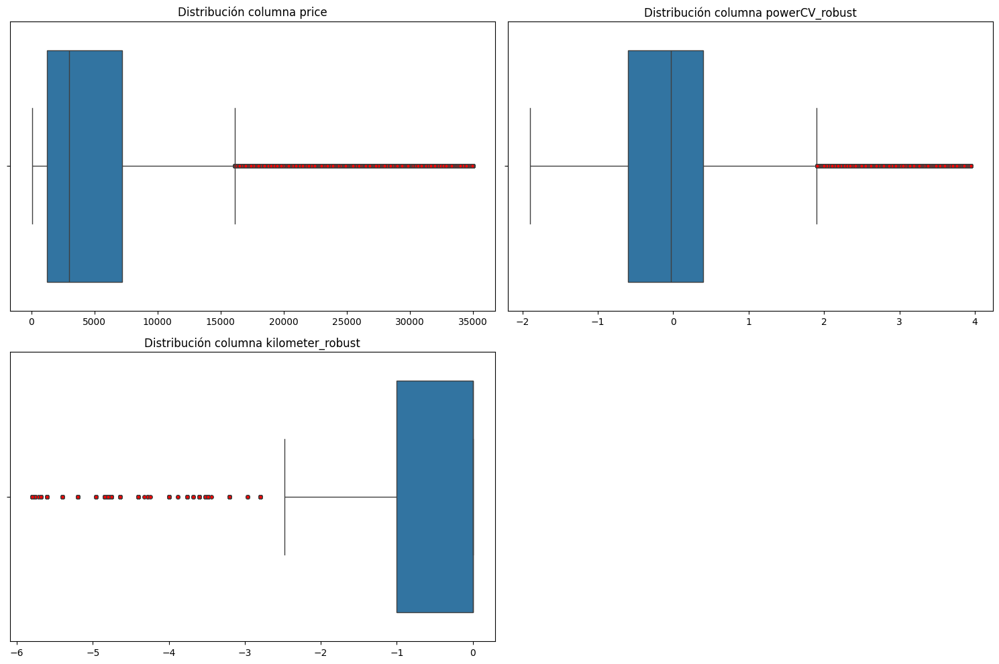

In [57]:
f.plot_outliers_univariados(df_filt, "b", (15,10))

In [58]:
df_robust_con3=df_robust[["price", "powerCV_robust", "kilometer_robust"]]

In [59]:
(df_filt["kilometer_robust"]< -2.5).sum()

np.int64(58854)

In [60]:
(df_robust_con3["kilometer_robust"]< -2.5).sum()

np.int64(58773)

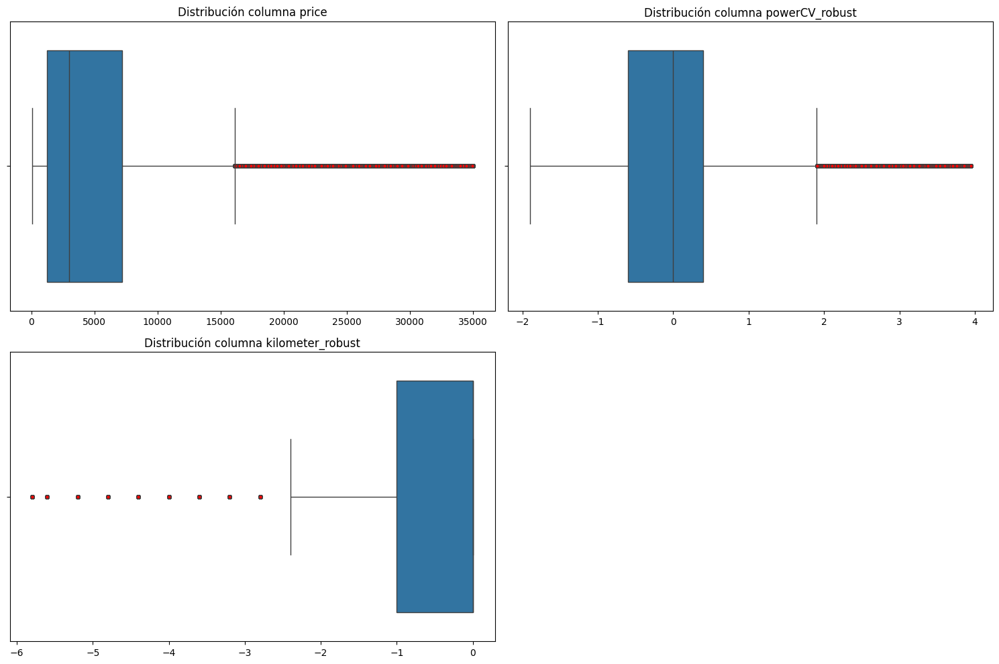

In [61]:
f.plot_outliers_univariados(df_robust_con3, "b", (15,10))

caso con iterative

In [62]:
df_numericas=df_result.select_dtypes(include=np.number)
df_numericas.drop(columns="price", inplace=True)
imputer_iterative= IterativeImputer()       #Aquí se puede poner el KNNImputer o el RandomForestRegressor
                                            #missing values es por si los nulos no estan como np.nan sino en texto por ejemplo (aunque lo suyo es limpiarlo en el EDA)
                                            #initial_strategy= "median" sirve para indicar que me lo haga con las medianas
iterative_imputado=imputer_iterative.fit_transform(df_numericas)   #como es solo para numericas se tiene que meter el df de numericas pero hay que definirlo otra vez porque hemos dropeado duplicados
df_iterativo=df_result.copy()
df_num_sin_nulos=pd.DataFrame(iterative_imputado, columns= df_numericas.columns)  #para que tenga los mismo nombres de columnas
df_iterativo[df_numericas.columns]= df_num_sin_nulos    #Con esto metemos todo el dataframe de las numericas sin nulos donde corresponda rellenando esos nulos

In [63]:
df_iterativo.isna().sum()

dateCrawled             0
seller                  0
offerType               0
price                   0
abtest                  0
vehicleType             0
yearOfRegistration      0
gearbox                 0
model                   0
monthOfRegistration     0
fuelType                0
brand                   0
notRepairedDamage       0
lastSeen                0
yearCreated             0
monthCreated            0
powerCV_robust          0
kilometer_robust        0
outliers_lof_0.01_20    0
outliers_lof_0.01_50    0
outliers_lof_0.05_20    0
outliers_lof_0.05_50    0
outliers_lof_0.1_20     0
outliers_lof_0.1_50     0
outliers_lof_0.01_8     0
outliers_lof_0.05_8     0
outliers_lof_0.1_8      0
dtype: int64

In [64]:
df_iterativo.describe().T

,count,mean,std,min,25%,50%,75%,max
price,354483.0,5361.441666,6000.874467,55.000000,1250.000000,3000.000000,7200.000000,34999.000000
powerCV_robust,354483.0,0.016097,0.873340,-1.896552,-0.603448,-0.034483,0.396552,3.948276
kilometer_robust,354483.0,-0.940077,1.558065,-5.800000,-1.000000,0.000000,0.000000,0.755449
outliers_lof_0.01_20,354483.0,0.981161,0.193191,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.01_50,354483.0,0.981201,0.192990,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.05_20,354483.0,0.901389,0.433011,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.05_50,354483.0,0.901169,0.433469,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.1_20,354483.0,0.801062,0.598582,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.1_50,354483.0,0.801062,0.598582,-1.000000,1.000000,1.000000,1.000000,1.000000
outliers_lof_0.01_8,354483.0,0.981161,0.193191,-1.000000,1.000000,1.000000,1.000000,1.000000


In [65]:
df_iterativo.to_csv("..\datos3\datos_sin_outliers_iterativo.csv")

In [66]:
df_it=pd.read_csv("..\datos3\datos_sin_outliers_iterativo.csv", index_col=0).reset_index(drop=True)

In [67]:
df_filt_it=df_it[["price", "powerCV_robust", "kilometer_robust"]]

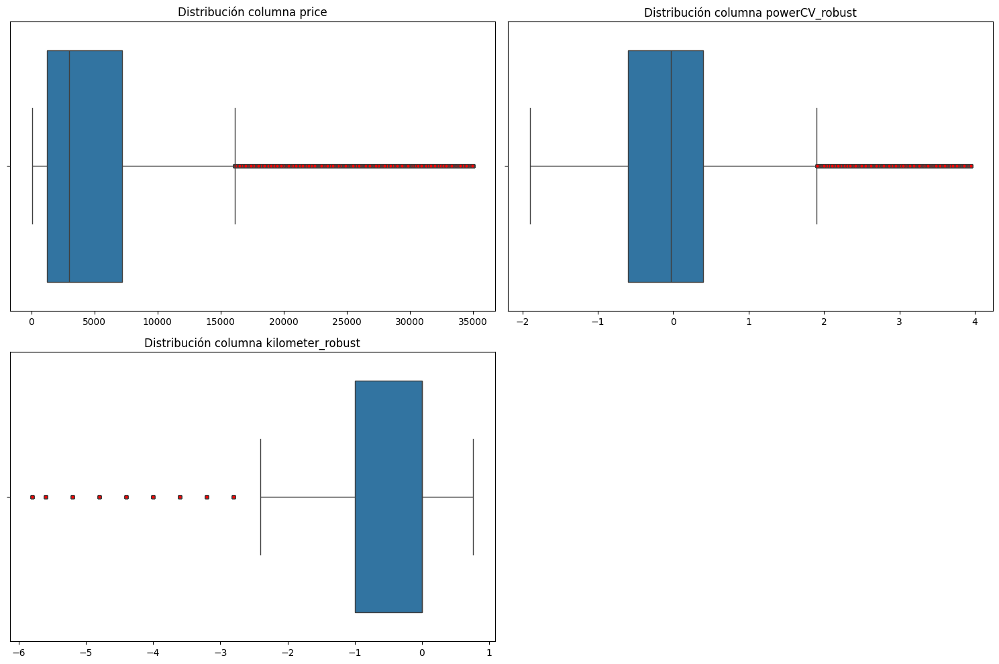

In [68]:
f.plot_outliers_univariados(df_filt_it, "b", (15,10))

In [69]:
df_robust_con3=df_robust[["price", "powerCV_robust", "kilometer_robust"]]

In [70]:
(df_filt_it["kilometer_robust"]< -2.5).sum()

np.int64(58717)

In [71]:
(df_robust_con3["kilometer_robust"]< -2.5).sum()

np.int64(58773)

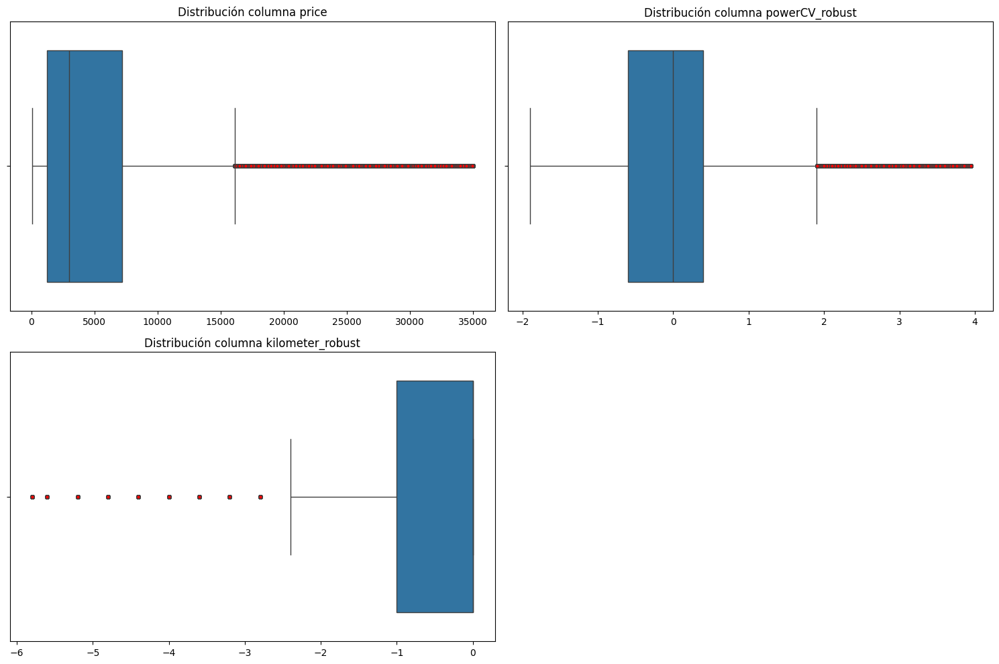

In [72]:
f.plot_outliers_univariados(df_robust_con3, "b", (15,10))

Ya están tratados

Observamos que con KNN nos crea más outliers de los que había originalmente mientras que con el iterative si que se tratan mejor. Por ello finalmente nos quedamos con el iterative